In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly_express as px
import seaborn as sns
# !pip install catboost --upgrade
# !pip install xgboost --upgrade
# !pip install lightgbm --upgrade

## Problem Statement:
We would like to predict the probability that a person X will buy a product Y. There are a bunch of largely demographic related features available about person X. There are also features available around X’s past activities. We also have aggregated data about people who typically buy product Y available as features (their demographics and past activities). We however do not know which features are which with certainty. The variable C tells us if the person X actually bought the product Y

### Reading Data 

In [2]:
path = '.'
df = pd.read_csv(path+'/ClassificationProblem1.txt', delimiter='\t')
df = df.drop('Index',axis=1)
df.head().T

,0,1,2,3,4
F1,0.224506,0.321128,0.893441,0.320641,0.475961
F2,0.50034,0.281119,0.622005,0.957234,0.623008
F3,0.48986,0.907283,0.998776,0.346,0.544988
F4,0.902413,0.772159,0.098386,0.646479,0.159709
F5,7934,-8238,8540,-7772,1571
F6,-6970,1219,5266,-383,-8039
F7,-5714,1663,-9377,9681,-7961
F8,9982,1287,-3504,-8661,-2385
F9,-5697,-3658,-4511,3474,4407
F10,4227810299,-1146724819,5947184989,-5724795826,-3097637172


In [3]:
df['F15'] = pd.to_datetime(df['F15'], format="%m/%d/%Y") #convert to datetime format
df['F16'] = pd.to_datetime(df['F16'], format="%m/%d/%Y")

df.head().T

,0,1,2,3,4
F1,0.224506,0.321128,0.893441,0.320641,0.475961
F2,0.50034,0.281119,0.622005,0.957234,0.623008
F3,0.48986,0.907283,0.998776,0.346,0.544988
F4,0.902413,0.772159,0.098386,0.646479,0.159709
F5,7934,-8238,8540,-7772,1571
F6,-6970,1219,5266,-383,-8039
F7,-5714,1663,-9377,9681,-7961
F8,9982,1287,-3504,-8661,-2385
F9,-5697,-3658,-4511,3474,4407
F10,4227810299,-1146724819,5947184989,-5724795826,-3097637172


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101180 entries, 0 to 101179
Data columns (total 23 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   F1      101180 non-null  float64       
 1   F2      101180 non-null  float64       
 2   F3      101180 non-null  float64       
 3   F4      101180 non-null  float64       
 4   F5      101180 non-null  int64         
 5   F6      101180 non-null  int64         
 6   F7      101180 non-null  int64         
 7   F8      101180 non-null  int64         
 8   F9      101180 non-null  int64         
 9   F10     101180 non-null  int64         
 10  F11     101180 non-null  int64         
 11  F12     101180 non-null  int64         
 12  F13     101180 non-null  int64         
 13  F14     101180 non-null  int64         
 14  F15     101180 non-null  datetime64[ns]
 15  F16     101180 non-null  datetime64[ns]
 16  F17     101180 non-null  int64         
 17  F18     101180 non-null  int6

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
F1,101180.0,5.023477e-01,2.880579e-01,1.844080e-05,2.538188e-01,5.018017e-01,7.535983e-01,9.999856e-01
F2,101180.0,5.014966e-01,2.890167e-01,3.709570e-06,2.511152e-01,5.010954e-01,7.524044e-01,9.999898e-01
F3,101180.0,4.998863e-01,2.888748e-01,1.758830e-06,2.488185e-01,4.998198e-01,7.502808e-01,9.999853e-01
F4,101180.0,4.998388e-01,2.887291e-01,5.640770e-06,2.505012e-01,5.013866e-01,7.488031e-01,9.999773e-01
F5,101180.0,-2.974262e+01,5.781829e+03,-1.000000e+04,-5.045000e+03,-4.600000e+01,4.978000e+03,1.000000e+04
F6,101180.0,1.511000e+00,5.796594e+03,-1.000000e+04,-5.012000e+03,-1.150000e+01,5.050000e+03,1.000000e+04
F7,101180.0,7.939118e+00,5.765582e+03,-1.000000e+04,-4.979000e+03,1.650000e+01,4.962000e+03,1.000000e+04
F8,101180.0,1.643415e+01,5.782805e+03,-1.000000e+04,-4.988000e+03,6.000000e+01,5.021000e+03,1.000000e+04
F9,101180.0,9.927812e+00,5.771005e+03,-1.000000e+04,-4.992250e+03,2.250000e+01,5.020000e+03,1.000000e+04
F10,101180.0,1.869749e+07,5.769064e+09,-9.999816e+09,-4.966961e+09,4.346691e+07,5.019440e+09,9.999497e+09


- all features are numeric except date-time features
- features f17 to f22 are integers with min value =1 (could be categorical)

In [6]:
df_plot = df.copy() #to avoid changes on orginal dataFrame

#tried different date-time feature engineering

# def create_dt_feats(df,col):
#     df[col+'quarter'] = df[col].dt.quarter
#     df[col+'year'] = df[col].dt.year
#     df[col+'month'] = df[col].dt.month
#     df[col+'day'] = df[col].dt.day
#     df[col+'weekOfYear'] = df[col].dt.weekofyear
#     df[col+'dayOfWeek'] = df[col].dt.dayofweek
#     df[col+'dayOfyear'] = df[col].dt.dayofyear
#     return df

# df_plot = create_dt_feats(df_plot,'F15')   
# df_plot = create_dt_feats(df_plot,'F16') 

df_plot['dt_diff'] = (df_plot['F16']-df_plot['F15']).dt.days #difference in days between the date feature columns
df_plot = df_plot.drop(['F15','F16'],axis=1)
df_plot.head()

,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,...,F13,F14,F17,F18,F19,F20,F21,F22,C,dt_diff
0,0.224506,0.500340,0.489860,0.902413,7934,-6970,-5714,9982,-5697,4227810299,...,6176861823,-3433637453,2,1,706,305,1,2,0,2164
1,0.321128,0.281119,0.907283,0.772159,-8238,1219,1663,1287,-3658,-1146724819,...,-9031507610,609277486,1,1,423,206,18,7,1,1411
2,0.893441,0.622005,0.998776,0.098386,8540,5266,-9377,-3504,-4511,5947184989,...,-5610051842,-8977995005,2,1,703,315,1,4,0,-782
3,0.320641,0.957234,0.346000,0.646479,-7772,-383,9681,-8661,3474,-5724795826,...,-4697085930,4868760308,1,1,122,304,15,1,0,3765
4,0.475961,0.623008,0.544988,0.159709,1571,-8039,-7961,-2385,4407,-3097637172,...,9984692447,9757408267,1,1,486,240,1,1,0,-538


- 

## Identifying Numerical and Categorical Features

In [7]:
nunique_df = df_plot.drop('C',axis=1).nunique().to_frame(name='n_unique')
nunique_df['col_name'] = nunique_df.index
nunique_df['dtypes'] = df_plot.drop('C',axis=1).dtypes
nunique_df = nunique_df.sort_values('n_unique').reset_index(drop=True)
nunique_df

,n_unique,col_name,dtypes
0,5,F18,int64
1,5,F17,int64
2,21,F21,int64
3,21,F22,int64
4,646,F20,int64
5,646,F19,int64
6,9769,dt_diff,int64
7,19862,F6,int64
8,19865,F7,int64
9,19866,F8,int64


In [8]:
fig = px.bar(nunique_df, y='col_name', x='n_unique', text='n_unique', height=1000)
fig.show()

In [9]:
#based on cardinality , dtype and min value , these features seems to be categorical
cat_cols = list(nunique_df[nunique_df['n_unique']<700]['col_name']) #based on cardinality , dtype and min value

In [10]:
num_cols = list(set(nunique_df['col_name'])-set(cat_cols))

In [11]:
print(f'Number of Numerical Columns Identified: {len(num_cols)}')
print(f'Number of Categorical Columns Identified: {len(cat_cols)}')

Number of Numerical Columns Identified: 15
Number of Categorical Columns Identified: 6


# EDA

## Distribution of Target feature

<AxesSubplot:xlabel='C', ylabel='count'>

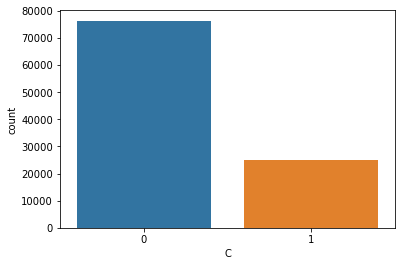

In [14]:
sns.countplot(x=df_plot['C'])

In [15]:
df_plot['C'].value_counts(normalize=True) # class imbalance

0    0.754625
1    0.245375
Name: C, dtype: float64

## Numeric Features Plots

### Univariate Plots

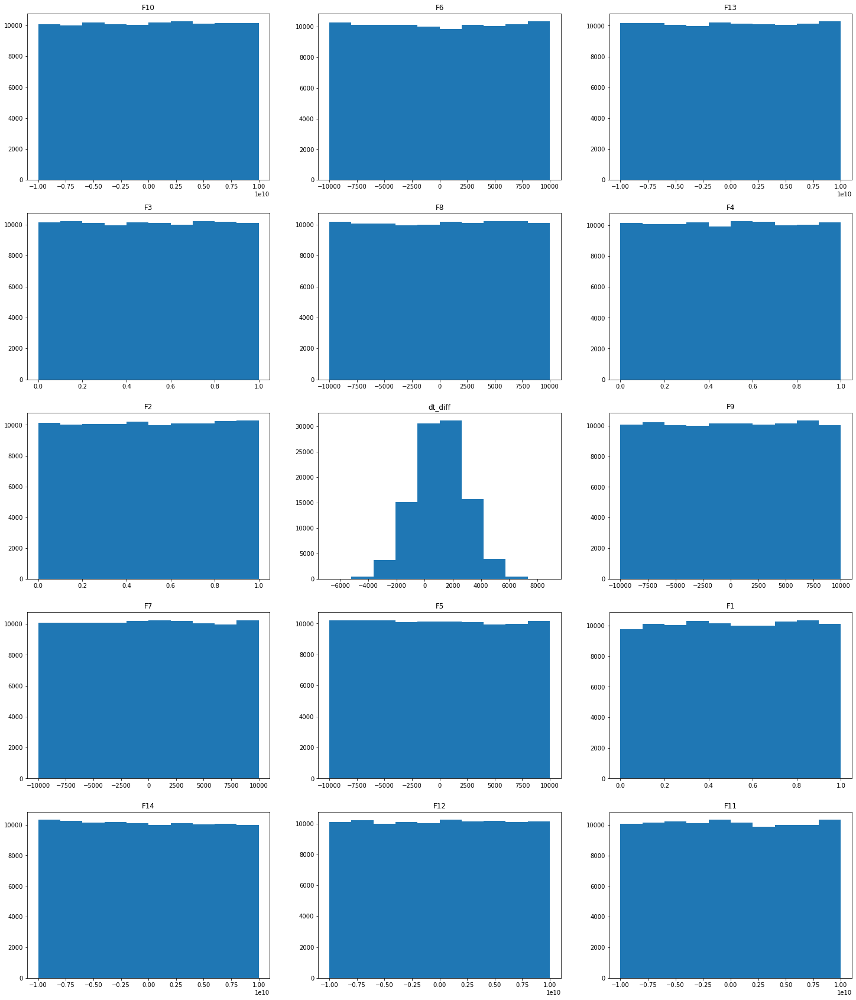

In [16]:
plt.figure(figsize=(25,30))
for i,j in enumerate(num_cols):
    plt.subplot(5,3,i+1)
    plt.title(j)
    plt.hist(df_plot[j])
    

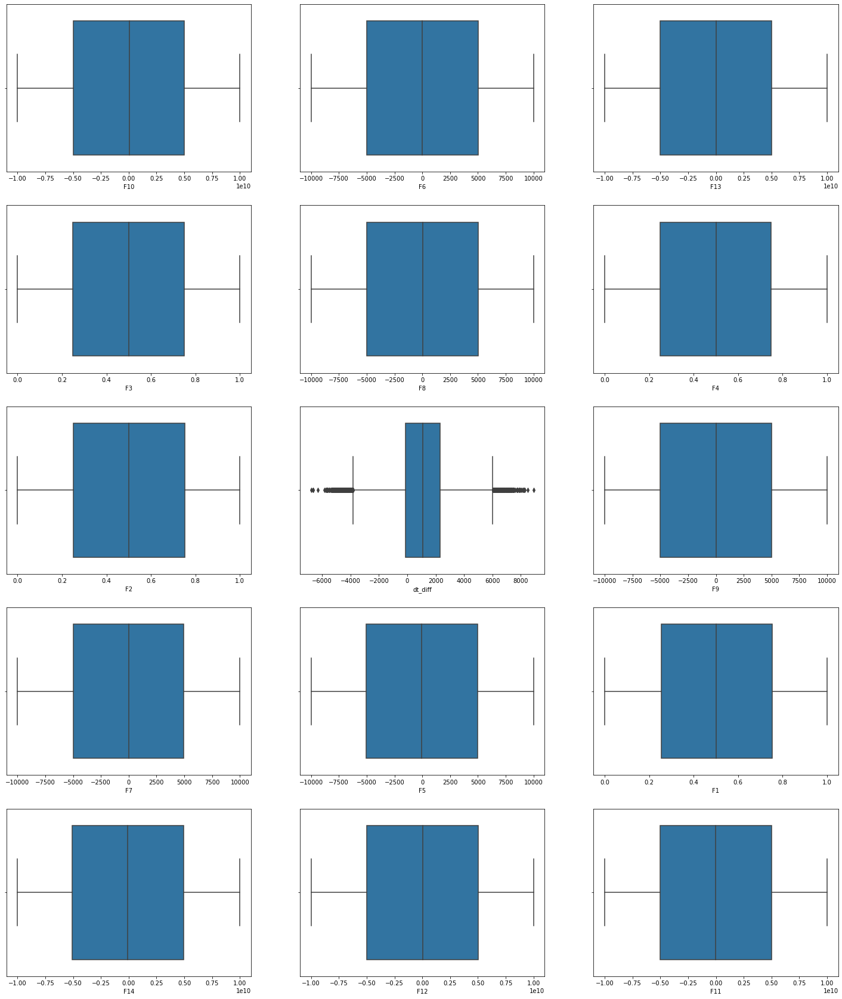

In [17]:
plt.figure(figsize=(25,30))
for i,j in enumerate(num_cols):
    plt.subplot(5,3,i+1)
    sns.boxplot(x=df_plot[j])

- all uniform distributions except dt_diff which seems to be approx normal
- no evident outliers

### Bivariate plots

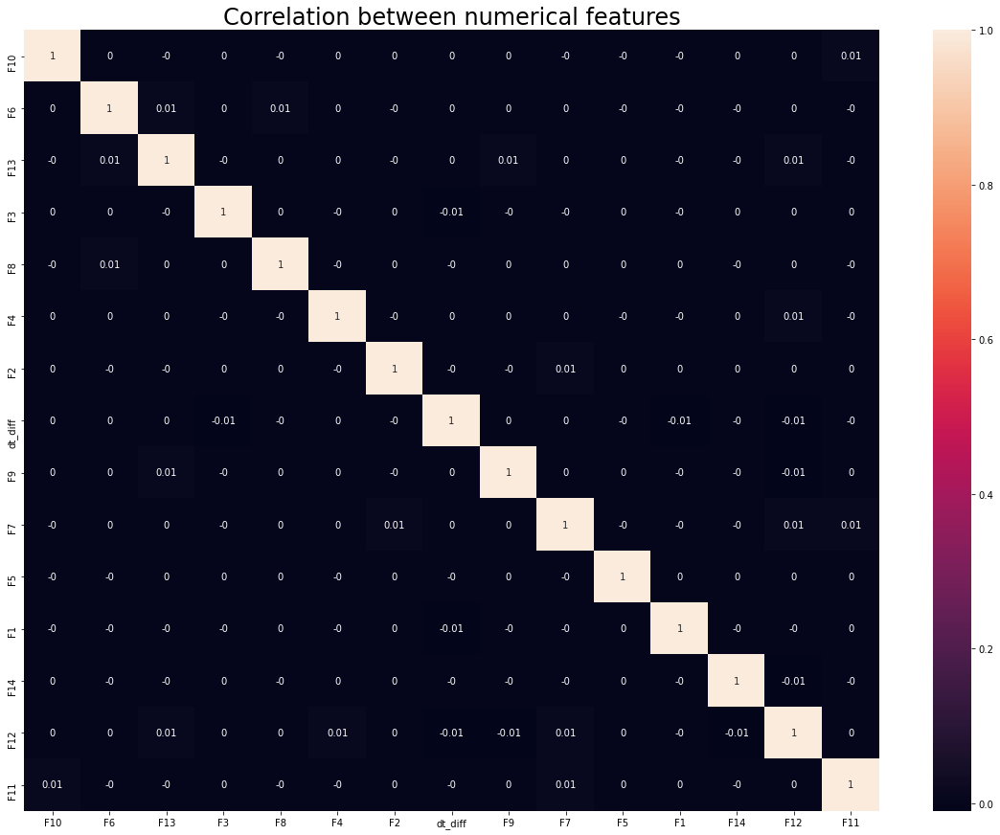

In [18]:
plt.figure(figsize=(20,15))
sns.heatmap(np.round(df_plot[num_cols].corr(),2),annot=True)
plt.title('Correlation between numerical features', fontsize=24)
plt.show()

### Numeric features vs target (bivariate plots with target)

In [19]:
df_corr = df_plot[num_cols+['C']].corr()[['C']].sort_values(by='C')[:-1].reset_index()
fig = px.bar(df_corr, y='C',x='index', color='C',
             title='Correlation of Numerical Features with target')
fig.show()

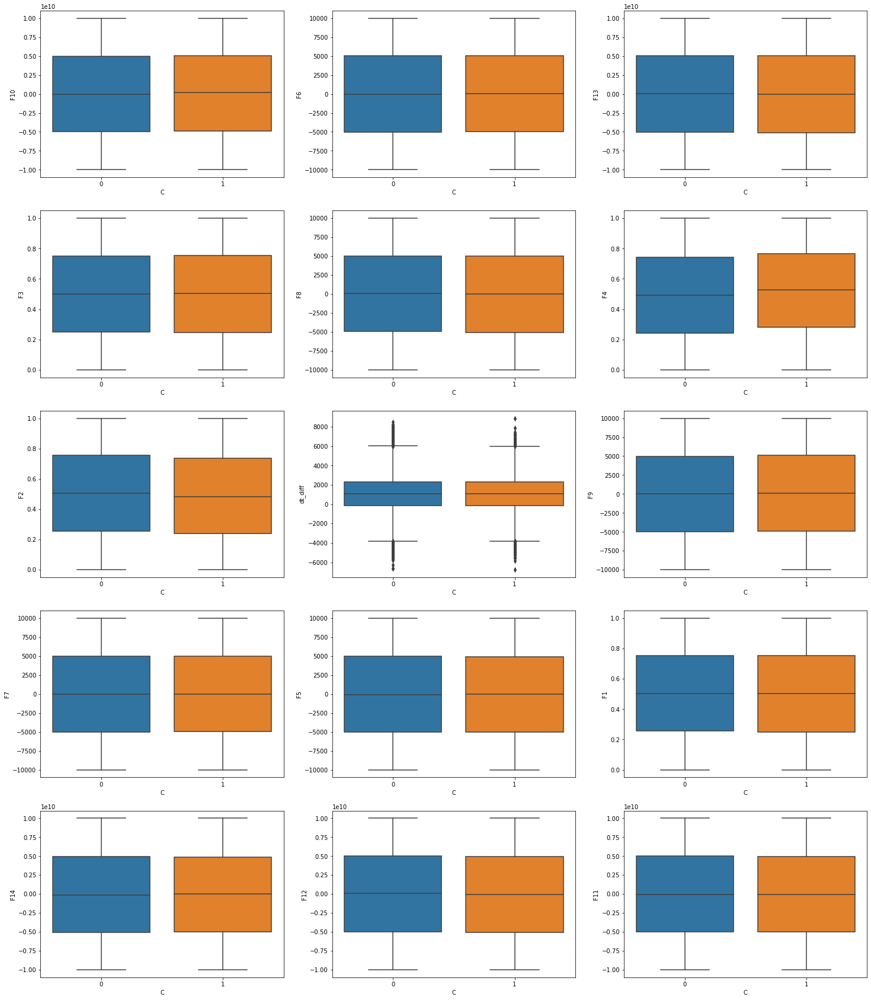

In [20]:
plt.figure(figsize=(25,30))
for i,j in enumerate(num_cols):
    plt.subplot(5,3,i+1)
    sns.boxplot(data=df_plot, x='C', y=j)

- no visible pattern

## Categorical Features Plots

### Univariate Plots (Count Plots)

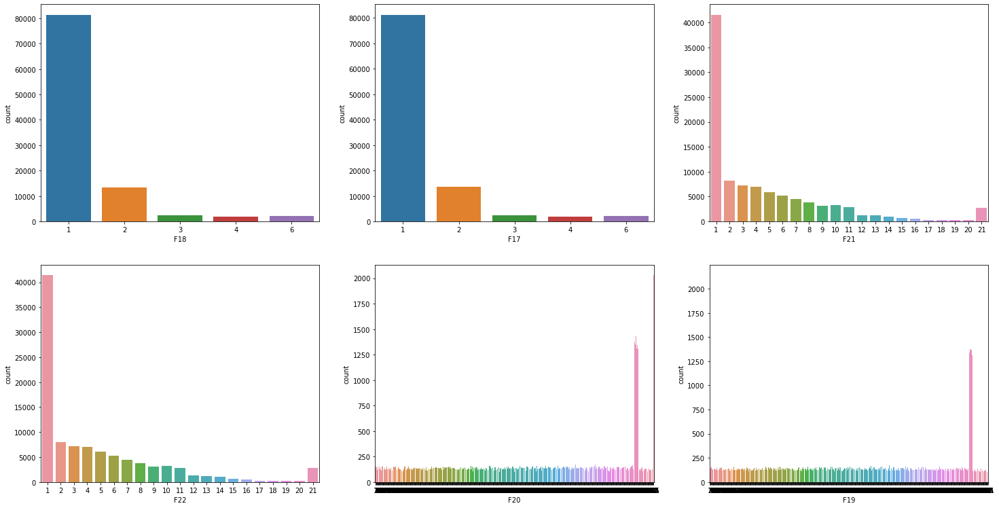

In [21]:
plt.figure(figsize=(25,20))
for i,j in enumerate(cat_cols):
    plt.subplot(3,3,i+1)
    sns.countplot(x=df_plot[j])

- there is imbalance among categories

### Categorical features vs target (bivariate plots with target)

In [22]:
def plot_cross_tabs(df, col):
    table_count = pd.crosstab(index=df[col], 
                              columns=df["C"])
    table_percent = pd.crosstab(index=df[col], 
                              columns=df["C"]).apply(lambda r: r/r.sum(), axis=1)
    fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(20,4))

    table_count.plot(kind="bar",
             stacked=True,ax=axes[0],title="Count Plot",rot=0)


    table_percent.plot(kind="bar",
                 stacked=True,ax=axes[1], title="Percent plot",rot=0)
    plt.xticks(rotation=0)
    plt.show()

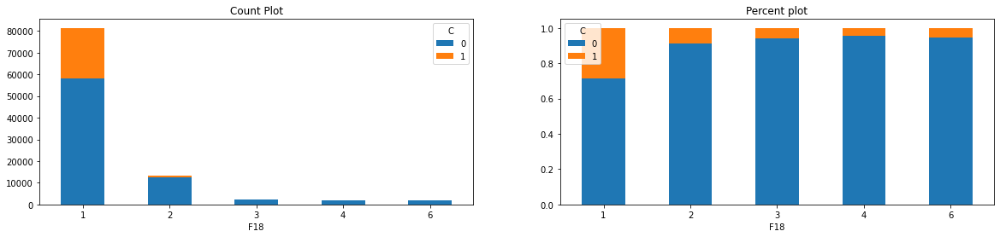

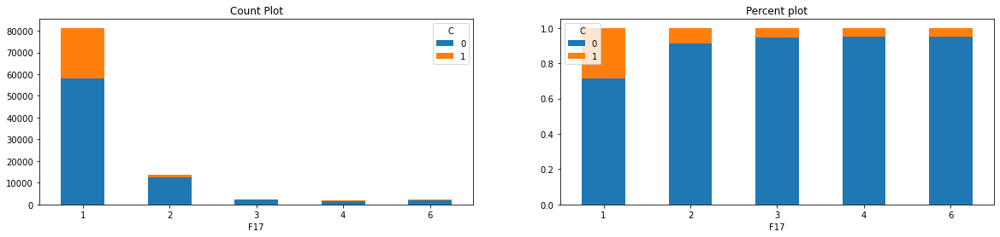

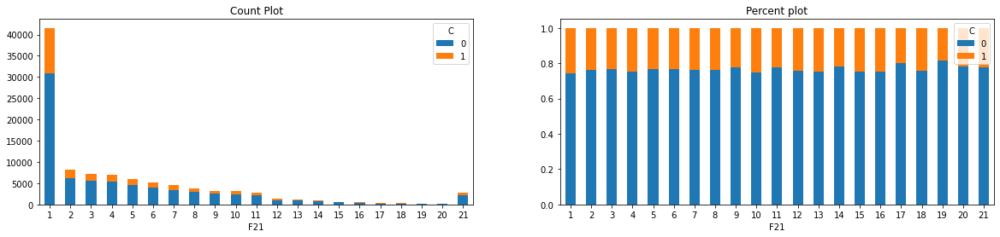

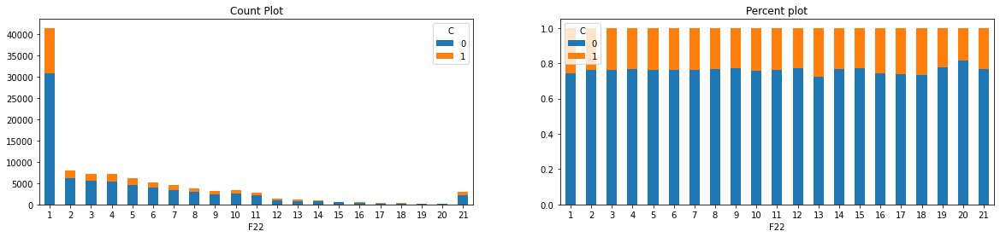

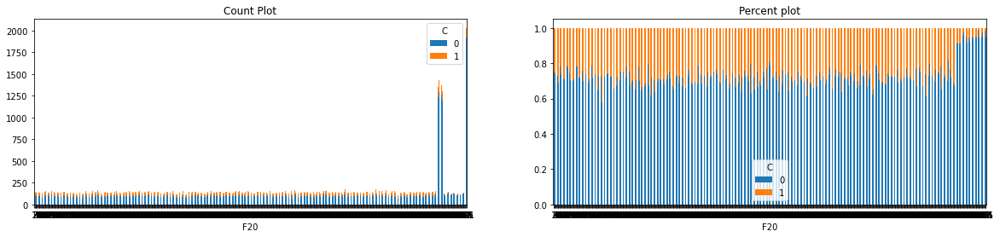

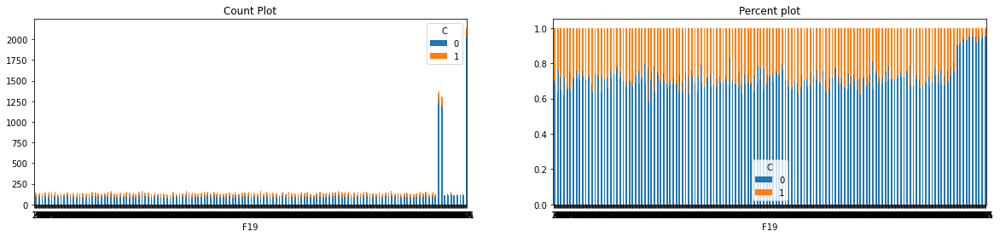

In [23]:
for i in cat_cols:
    plot_cross_tabs(df_plot, i)

- some categorical features seems somewhat 'paired' (pairs are having exactly same categories with exactly same distribution)
- initially i thought they could be duplicates but when checked , then they were not duplicates w.r.t each row/datapoint

In [24]:
#feature engineering based on above observation
df_plot['F1920'] = (df_plot['F19']==df_plot['F20']).astype(int)  #  whether 'paired features' matches for each example/row/datapoint
df_plot['F2122'] = (df_plot['F21']==df_plot['F22']).astype(int)
df_plot['F1718'] = (df_plot['F17']==df_plot['F18']).astype(int)
binary_cols = ['F1718','F2122','F1920']

### Plots of binary columns created

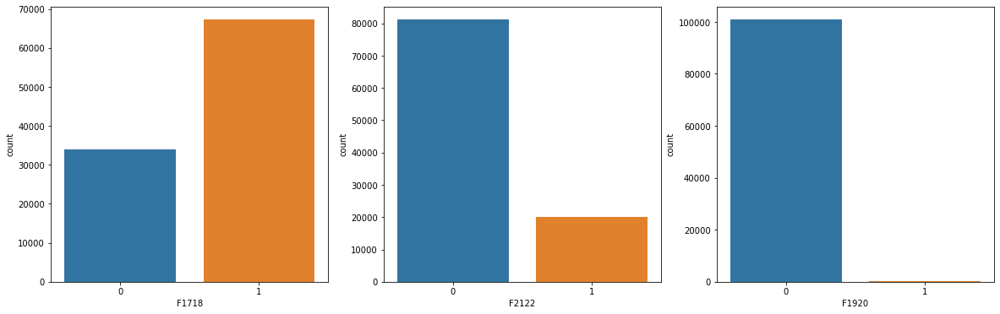

In [25]:
plt.figure(figsize=(20,6)) # countplots
for i,j in enumerate(binary_cols):
    plt.subplot(1,3,i+1)
    sns.countplot(x=df_plot[j])

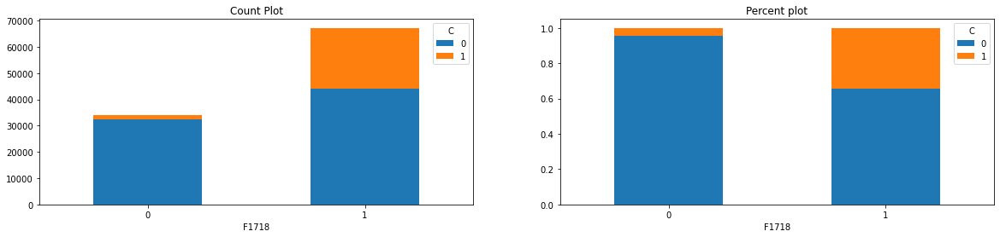

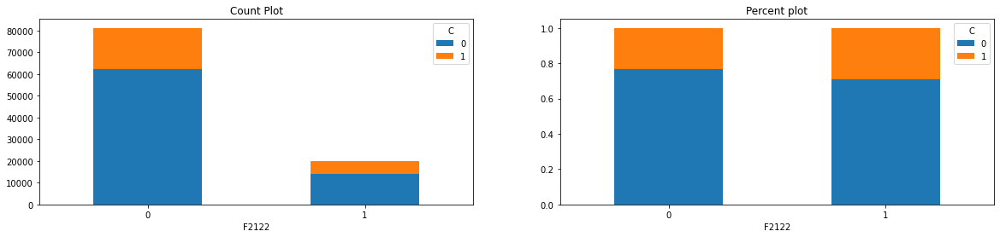

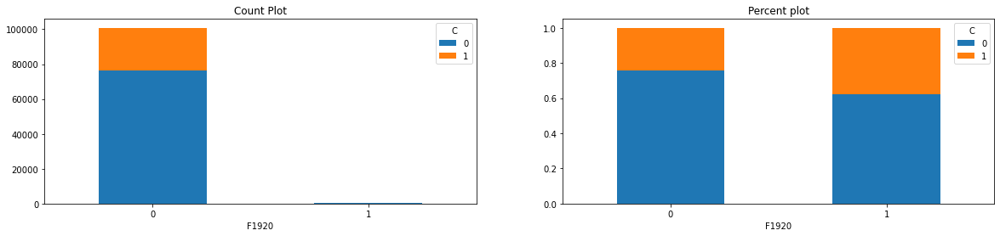

In [26]:
for i in binary_cols:
    plot_cross_tabs(df_plot, i) # bivariate with targets

- these features seems to be showing some pattern and could be useful to predict target

## Creating Feature Engineering Pipeline
- I will put together all the feature engineering till now in one single pipeline function to ease reproducibility
- This will be useful when these pre-processing has to be applied again , like on new raw data that comes for prediction later 

In [27]:
from sklearn.base import TransformerMixin, BaseEstimator

In [28]:
class feat_eng_pipe(BaseEstimator, TransformerMixin): # this class can be combined sequentially with others to create a bigger pipeline if needed
    def fit(self, X, y=None, **kwargs):
        return self
    def transform(self, X, y=None, **kwargs):
        df = X.copy()

        index = df.pop('Index')
        df['F15'] = pd.to_datetime(df['F15'], format="%m/%d/%Y") #convert to datetime format
        df['F16'] = pd.to_datetime(df['F16'], format="%m/%d/%Y")

        df['dt_diff'] = (df['F16']-df['F15']).dt.days #difference in days between the date feature columns
        df = df.drop(['F15','F16'],axis=1)

        df['F1920'] = (df['F19']==df['F20']).astype(int)  # checking whether a pair matches
        df['F2122'] = (df['F21']==df['F22']).astype(int)
        df['F1718'] = (df['F17']==df['F18']).astype(int)

        return df

# Splitting for training, validation and testing

In [29]:
X = df_plot.drop('C',axis=1)
y = df_plot['C']

In [30]:
from sklearn.model_selection import train_test_split
seed = 10
test_size = 0.2
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size = test_size,
                                                    random_state = seed, 
                                                    stratify = y)

In [31]:
seed = 10
test_size = 0.2
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train,
                                                    test_size = test_size,
                                                    random_state = seed, 
                                                    stratify = y_train)
print('Percentage of pos label in training: ',y_train.mean())
print('Percentage of pos label in validation: ',y_valid.mean())
print('Percentage of pos label in testing: ',y_test.mean())

Percentage of pos label in training:  0.24538645664427458
Percentage of pos label in validation:  0.24535178207424796
Percentage of pos label in testing:  0.24535481320419056


# Creating Models

In [32]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_recall_curve, average_precision_score, confusion_matrix
from sklearn.metrics import classification_report, f1_score, recall_score, precision_score, ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler
import optuna
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
import plotly.graph_objects as go
from plotly.subplots import make_subplots

- I will use PR-AUC instead of ROC-AUC to evaluate our models because PR-AUC is more suitable for imabalanced data
- The only difference between them is how they treat TN values
- In PR curves TN is not at all used
- Hence, in situations where TN are less important - PR curve will be more suitable
- Class Imbalance is usually such a situation 
- LogLoss is another metric that could be used, but logloss is best suitable for application where 'well-calibrated probabilities' are needed
- also logloss is diffrentiable and hence is the default loss function for algorithms using gradient-descent like NeuralNets and Boosters
- ROC-AUC and PR-AUC can make statements like 'this is more likely to be an apple than orange'.They are ranking metrics and suitable when we just need crisp labels i.e we just want seperation
- logloss can make statements like 'there is 75% probabiity that it is an apple.

In [33]:
def plot_pr_curve(y_true, y_pred_prob): #plots precision recall curve and gives the labels correspinding to best thresholds ( at best f1 score )
    precision, recall, thresholds = precision_recall_curve(y_true, y_pred_prob)
    numerator = 2 * recall * precision
    denom = recall + precision
    f1_scores = np.divide(numerator, denom, out=np.zeros_like(denom), where=(denom!=0)) #f1 scores at each thresh
    prauc = np.round(average_precision_score(y_true, y_pred_prob),2) 
    
    fig = make_subplots(1,2,subplot_titles=['Precision Vs Recall', 'PRF Vs Threshold'])   
    fig.add_trace(go.Scatter(x=recall, y=precision, name='P vs R'),1,1)
    fig.update_xaxes(title='Recall', row=1,col=1)
    fig.update_yaxes(title='Precision', row=1,col=1)
    fig.update_layout(title=f'Area Under Precision-Recall Curve: {prauc}',hovermode="x")
    

    fig.add_trace(go.Scatter(x=thresholds, y=f1_scores[:-1], name='F1 Score'),1,2)
    fig.add_trace(go.Scatter(x=thresholds, y=recall[:-1], name='Recall'),1,2)
    fig.add_trace(go.Scatter(x=thresholds, y=precision[:-1], name='Precision'),1,2)
    fig.update_xaxes(title='Thresholds', row=1,col=2)
    fig.update_yaxes(title='Precision and Recall',row=1,col=2)
    
    
    best_thresh = thresholds[np.argmax(f1_scores)] #threshold tuning for best f1 score
    
    fig.add_annotation(x=recall[np.argmax(f1_scores)], y=precision[np.argmax(f1_scores)], xref='x1', yref='y1',
            text=f"Best F1 score",
            showarrow=True,
            arrowhead=1)
    
    fig.add_annotation(x=best_thresh, y=max(f1_scores), xref='x2', yref='y2',
            text=f"Best F1 score",
            showarrow=True,
            arrowhead=1) 
    
    fig.show()
    
    return best_thresh


## Logistic Regression

In [34]:
### preprocessing for logistic Regression
scaler = StandardScaler()

X_train_scaled_transformed = scaler.fit_transform(X_train)
X_valid_scaled_transformed = scaler.transform(X_valid)
X_test_scaled_transformed = scaler.transform(X_test)

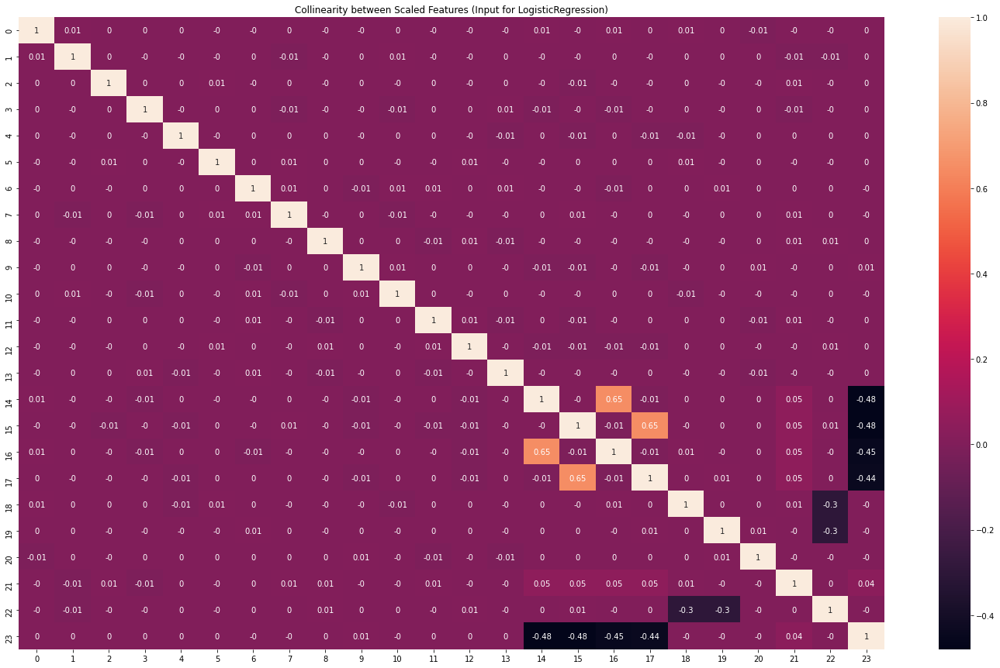

In [35]:
plt.figure(figsize=(25,15))
sns.heatmap(np.round(pd.DataFrame(X_train_scaled_transformed).corr(),2),annot=True)
plt.title('Collinearity between Scaled Features (Input for LogisticRegression)')
plt.show()

In [36]:
# # hyperparameter tuning
# def objective(trial):
 
#     param = {
#         'max_iter':500,
#         'penalty': 'l2',
#         'class_weight':'balanced',
# #         'solver': 'saga',
#         'C': trial.suggest_loguniform('C', 1e-5, 50),
#     }
 
#     lr = LogisticRegression(**param)
    
#     lr.fit(X_train_scaled_transformed, y_train)
    
#     y_pred_prob = lr.predict_proba(X_valid_scaled_transformed)[:,1]
#     score = average_precision_score(y_valid, y_pred_prob)
#     return score

# study_lr1 = optuna.create_study(direction='maximize')
# study_lr1.optimize(objective, n_trials=30)

In [37]:
lr1_best_params = {'C': 3.6183378306868987}

In [38]:
lr1 = LogisticRegression(
                        class_weight='balanced',
                        max_iter=500,
#                         **study_lr1.best_params
                        **lr1_best_params
                        )

lr1.fit(X_train_scaled_transformed, y_train)


y_pred_prob_lr = lr1.predict_proba(X_valid_scaled_transformed)[:,1]

lr_best_thresh = plot_pr_curve(y_valid, y_pred_prob_lr)
y_pred = np.where(y_pred_prob_lr>=lr_best_thresh, 1, 0) #creating labels based on best threshold

- These curves give a more detailed view about our predictions
- These graph clearly highlights the trade-off between precision and recall at different thresholds
- Based on what is more important we decide a threshold accordingly i.e there is no universal good or bad threshold
- In other words, we find a threshold which will be most rewarding/profitable w.r.t our use case
- Here assuming both presion and recall are equally important, i have tuned the threshold to give best f1 score

In [39]:
def show_report(y_true,y_pred):
    print(classification_report(y_true,y_pred))
    print()
    disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_true, y_pred))
    disp.plot() 
    plt.title('Confusion Matrix')
    plt.show()

              precision    recall  f1-score   support

           0       0.95      0.44      0.60     12217
           1       0.35      0.93      0.51      3972

    accuracy                           0.56     16189
   macro avg       0.65      0.69      0.56     16189
weighted avg       0.80      0.56      0.58     16189




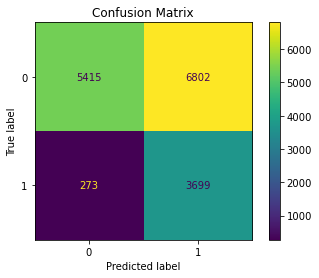

In [40]:
show_report(y_valid,y_pred)

In [41]:
criteria1 = []
criteria1.append(['LogisticRegression',
                  average_precision_score(y_valid, y_pred_prob_lr),
                  precision_score(y_valid,y_pred), 
                  recall_score(y_valid,y_pred), 
                  f1_score(y_valid,y_pred)])

In [42]:
feat_imp_lr1=pd.DataFrame({'Feature':X_train.columns, 'CoeffValue':lr1.coef_[0]}).sort_values(by='CoeffValue')
fig = px.bar(feat_imp_lr1, y='CoeffValue', x='Feature', color='CoeffValue',
            title='Feature Importance by Logistic Regression')
fig.update_traces(width=0.5)
fig.show()

## Random Forest

In [43]:
# def objective(trial):
 
#     param = {
#         'n_estimators':100,
#         'class_weight':'balanced',
#         'n_jobs':-1,
#         'random_state':3,
#         'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 16),
#         'max_features': trial.suggest_uniform('max_features', 0.3, 1.0),
#         'max_samples': trial.suggest_uniform('max_samples', 0.3, 1.0),
#     }
 
#     rf = RandomForestClassifier(**param)    
#     rf.fit(X_train.values, y_train.values)
    
    
#     y_pred = rf.predict_proba(X_valid.values)[:,1]
#     score = average_precision_score(y_valid ,y_pred)
#     return score

# study_rf1 = optuna.create_study(direction='maximize')
# study_rf1.optimize(objective, n_trials=50)

In [44]:
rf1_best_params = {'min_samples_leaf': 14,
 'max_features': 0.9408352253927614,
 'max_samples': 0.7184488535647534}

In [45]:
rf1 = RandomForestClassifier(n_estimators=100,
                            class_weight='balanced',
                            n_jobs=-1,
                            random_state= 3,
#                             **study_rf1.best_params
                            **rf1_best_params
                            )
rf1.fit(X_train.values, y_train.values)

y_pred_prob_rf = rf1.predict_proba(X_valid.values)[:,1]

rf_best_thresh = plot_pr_curve(y_valid, y_pred_prob_rf)
y_pred = np.where(y_pred_prob_rf>=rf_best_thresh, 1, 0) #creating labels based on best threshold

              precision    recall  f1-score   support

           0       0.95      0.44      0.60     12217
           1       0.35      0.93      0.51      3972

    accuracy                           0.56     16189
   macro avg       0.65      0.69      0.56     16189
weighted avg       0.80      0.56      0.58     16189




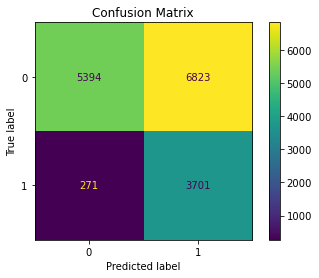

In [46]:
show_report(y_valid,y_pred)

In [47]:
criteria1.append(['RandomForest',
                  average_precision_score(y_valid, y_pred_prob_rf),
                  precision_score(y_valid,y_pred),
                  recall_score(y_valid,y_pred),
                  f1_score(y_valid,y_pred)])

In [48]:
feat_imp_rf1=pd.DataFrame({'Feature':X_train.columns, 'Value':rf1.feature_importances_}).sort_values(by='Value', ascending=False)
fig = px.bar(feat_imp_rf1, y='Value', x='Feature', color='Value',
             title='Feature Importance by Random Forest')
fig.show()

## XGBoost

In [49]:
# def objective(trial):
#     param = {
#         'learning_rate':0.1,
#         'n_estimators':500,
#         'scale_pos_weight':3.05,
#         'random_state':3,
#         'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-4, 10.0),
#         'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-4, 10.0),
#         'max_depth': trial.suggest_int('max_depth', 2, 31),
#         'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.4, 1.0),
#         'subsample': trial.suggest_uniform('subsample', 0.4, 1.0),
#     }
 
#     xgb = XGBClassifier(**param)
    
#     xgb.fit(X_train, y_train,
#             eval_set=[(X_valid, y_valid)],
#             early_stopping_rounds=10,
#             eval_metric=['aucpr'],
#             verbose=0)
    
#     y_pred = xgb.predict_proba(X_valid)[:,1]
#     score = average_precision_score(y_valid,y_pred)
#     return score

# studyxgb1 = optuna.create_study(direction='maximize')
# studyxgb1.optimize(objective, n_trials=50)

In [50]:
xgb1_best_params = {'reg_lambda': 0.07044759025336625,
 'reg_alpha': 9.47766194265377,
 'max_depth': 8,
 'colsample_bytree': 0.7763551681956388,
 'subsample': 0.6948015409399589}

In [51]:
xgb1 = XGBClassifier(learning_rate=0.1,
                     n_estimators=500,
                    scale_pos_weight=3.05,
                      random_state=3,
#                      **studyxgb1.best_params
                    **xgb1_best_params
                     )

xgb1.fit(X_train, y_train,
        eval_set=[(X_valid, y_valid)],
        early_stopping_rounds=10,
        eval_metric=['aucpr'],
        verbose=0)

y_pred_prob_xgb = xgb1.predict_proba(X_valid)[:,1]

xgb_best_thresh = plot_pr_curve(y_valid, y_pred_prob_xgb)
y_pred = np.where(y_pred_prob_xgb>=xgb_best_thresh, 1, 0) #creating labels based on best threshold

C:\Users\amanc\Anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



              precision    recall  f1-score   support

           0       0.95      0.46      0.62     12217
           1       0.36      0.92      0.51      3972

    accuracy                           0.57     16189
   macro avg       0.65      0.69      0.57     16189
weighted avg       0.80      0.57      0.59     16189




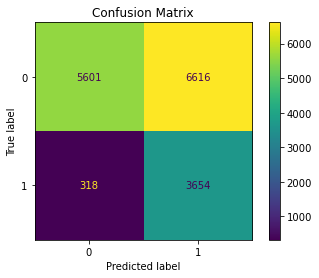

In [52]:
show_report(y_valid,y_pred)

In [53]:
criteria1.append(['XGBoost',
                  average_precision_score(y_valid, y_pred_prob_xgb),
                  precision_score(y_valid,y_pred), 
                  recall_score(y_valid,y_pred), 
                  f1_score(y_valid,y_pred)])

In [54]:
feat_imp_xgb1=pd.DataFrame({'Feature':X_train.columns, 'Value':xgb1.feature_importances_}).sort_values(by='Value', ascending=False)
fig = px.bar(feat_imp_xgb1, y='Value', x='Feature', color='Value', 
             title='Feature Importance by XGBoost')
fig.show()

## LightGBM

In [55]:
# def objective(trial):
#     param = {
#         'learning_rate':0.05,
#         'n_estimators':500,
#         'scale_pos_weight':3.05,
#         'random_state':3,
#         'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-4, 10.0),
#         'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-4, 10.0),
#         'num_leaves': trial.suggest_int('num_leaves', 2, 2043),
#         'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.4, 1.0),
#         'subsample': trial.suggest_uniform('subsample', 0.4, 1.0),
#         'min_child_samples': trial.suggest_int('min_child_samples', 5, 255)
#     }
 
#     lgb = LGBMClassifier(**param)
    
#     lgb.fit(X_train, y_train,
#             eval_set=(X_valid, y_valid),
#             early_stopping_rounds=10,
#             eval_metric=['average_precision'],
#             verbose=0)
    
#     y_pred = lgb.predict_proba(X_valid)[:,1]
#     score = average_precision_score(y_valid,y_pred)
#     return score

# studylgb1 = optuna.create_study(direction='maximize')
# studylgb1.optimize(objective, n_trials=100)

In [56]:
lgb1_best_params = {'reg_lambda': 0.001193644439115103,
 'reg_alpha': 0.013520323564644565,
 'num_leaves': 118,
 'colsample_bytree': 0.937912883611939,
 'subsample': 0.6231781176606416,
 'min_child_samples': 17}

In [57]:
lgb1 = LGBMClassifier(learning_rate=0.05,
                     n_estimators=500,
                     scale_pos_weight=3.05,
                     random_state=3,
#                      **studylgb1.best_params
                    **lgb1_best_params
                     )

lgb1.fit(X_train, y_train,
        eval_set=(X_valid, y_valid),
        early_stopping_rounds=10,
        eval_metric=['average_precision'],
        verbose=0)

y_pred_prob_lgb = lgb1.predict_proba(X_valid)[:,1]

lgb_best_thresh = plot_pr_curve(y_valid, y_pred_prob_lgb)
y_pred = np.where(y_pred_prob_lgb>=lgb_best_thresh, 1, 0) #creating labels based on best threshold

              precision    recall  f1-score   support

           0       0.94      0.46      0.62     12217
           1       0.36      0.91      0.51      3972

    accuracy                           0.57     16189
   macro avg       0.65      0.69      0.57     16189
weighted avg       0.80      0.57      0.59     16189




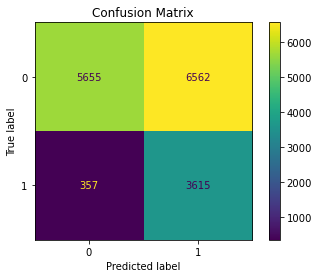

In [58]:
show_report(y_valid,y_pred)

In [59]:
criteria1.append(['LightGBM',
                  average_precision_score(y_valid, y_pred_prob_lgb),
                  precision_score(y_valid,y_pred), 
                  recall_score(y_valid,y_pred), 
                  f1_score(y_valid,y_pred)])

In [60]:
feat_imp_lgb1=pd.DataFrame({'Feature':X_train.columns, 'Value':lgb1.feature_importances_}).sort_values(by='Value', ascending=False)
fig = px.bar(feat_imp_lgb1, y='Value', x='Feature', color='Value',
             title='Feature Importance by LightGBM')
fig.show()

## Catboost

In [61]:
from catboost import CatBoostClassifier, Pool

In [62]:
# def objective(trial):
#     param = {
#         'learning_rate':0.07,
#         'n_estimators':500,
#         'scale_pos_weight':3.05,
#         'random_state':3,
#         'cat_features':cat_cols+binary_cols,
#         'eval_metric':'PRAUC',
#         'random_strength': trial.suggest_loguniform('random_strength', 1e-9, 10.0),
#         'depth': trial.suggest_int('depth', 1, 16),
#         'bagging_temperature': trial.suggest_uniform('bagging_temperature', 0.0, 1.0),
#         'l2_leaf_reg': trial.suggest_int('l2_leaf_reg', 1, 50),
#         'border_count': trial.suggest_int('border_count', 1, 255),
#     }
 
#     cb = CatBoostClassifier(**param)
    
#     cb.fit(X_train, y_train,
#             eval_set=(X_valid, y_valid),
#             early_stopping_rounds=10,
#             verbose=0)
    
#     y_pred = cb.predict_proba(X_valid)[:,1]
#     score = average_precision_score(y_valid,y_pred)
#     return score

# studycb1 = optuna.create_study(direction='maximize')
# studycb1.optimize(objective, n_trials=100)

In [63]:
cb1_best_params = {'random_strength': 0.03299292271633392,
 'depth': 8,
 'bagging_temperature': 0.17868049094715494,
 'l2_leaf_reg': 22,
 'border_count': 254}

In [64]:
cb1 = CatBoostClassifier(learning_rate=0.07,
        n_estimators=500,
        scale_pos_weight=3.05,
        random_state=3,
        cat_features=cat_cols+binary_cols,
        eval_metric='PRAUC',
#                      **studylgb1.best_params
                    **cb1_best_params
                     )

cb1.fit(X_train, y_train,
        eval_set=(X_valid, y_valid),
        early_stopping_rounds=10,
        verbose=0)

y_pred_prob_cb = cb1.predict_proba(X_valid)[:,1]

cb_best_thresh = plot_pr_curve(y_valid, y_pred_prob_cb)
y_pred = np.where(y_pred_prob_cb>=cb_best_thresh, 1, 0) #creating labels based on best threshold

              precision    recall  f1-score   support

           0       0.91      0.54      0.68     12217
           1       0.37      0.84      0.52      3972

    accuracy                           0.61     16189
   macro avg       0.64      0.69      0.60     16189
weighted avg       0.78      0.61      0.64     16189




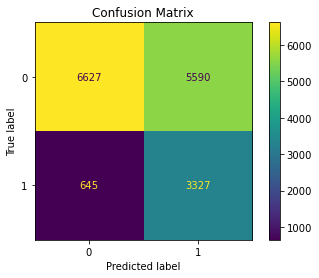

In [65]:
show_report(y_valid,y_pred)

In [66]:
criteria1.append(['CatBoost',
                  average_precision_score(y_valid, y_pred_prob_cb),
                  precision_score(y_valid,y_pred), 
                  recall_score(y_valid,y_pred), 
                  f1_score(y_valid,y_pred)])

In [67]:
feat_imp_lgb1=pd.DataFrame({'Feature':X_train.columns, 'Value':cb1.feature_importances_}).sort_values(by='Value', ascending=False)
fig = px.bar(feat_imp_lgb1, y='Value', x='Feature', color='Value',
             title='Feature Importance by Catboost')
fig.show()

# Model Comparision

In [68]:

model_compare1 = pd.DataFrame(criteria1, columns=['Model', 'PR_AUC', 'Precision', 'Recall', 'F1_Score']).sort_values(by='PR_AUC', ascending=False)
model_compare1[['PR_AUC', 'Precision','Recall','F1_Score']] = model_compare1[['PR_AUC', 'Precision', 'Recall','F1_Score']].round(2)

fig = make_subplots(1,4,subplot_titles=['PR_AUC','Recall', 'Precision', 'F1_Score'])
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['PR_AUC'], width=0.4,
                     text=model_compare1['PR_AUC'],textposition='auto',
                     name='PR_AUC'),1,1)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['Recall'], width=0.4,
                     text=model_compare1['Recall'],textposition='auto',
                     name='Recall'),1,2)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['Precision'], width=0.4,
                     text=model_compare1['Precision'],textposition='auto',
                     name='Precision'),1,3)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['F1_Score'], width=0.4,
                     text=model_compare1['F1_Score'],textposition='auto',
                     name='F1_Score'),1,4)
fig.update_layout(title='Model Comparisons',height=450, bargap=0.5, bargroupgap=0.1, template='seaborn', showlegend=False)

fig.show()

fig = make_subplots(1,3,subplot_titles=['PR-AUC with Recall', 'PR-AUC with Precision', 'PR-AUC with F1_Score'])
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['PR_AUC'], width=0.3,
                     text=model_compare1['PR_AUC'],textposition='auto',
                     name='PR_AUC'),1,1)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['Recall'], width=0.3,
                     text=model_compare1['Recall'],textposition='auto',
                     name='Recall'),1,1)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['PR_AUC'], width=0.3,
                     text=model_compare1['PR_AUC'],textposition='auto',
                     name='PR_AUC', marker_color='#4c72b0', showlegend=False),1,2)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['F1_Score'], width=0.3,
                     text=model_compare1['Precision'],textposition='auto',
                     name='Precision', marker_color='#55a868', showlegend=True),1,2)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['PR_AUC'], width=0.3,
                     text=model_compare1['PR_AUC'],textposition='auto',
                     name='PR_AUC', marker_color='#4c72b0', showlegend=False),1,3)
fig.add_trace(go.Bar(x=model_compare1['Model'], y=model_compare1['F1_Score'], width=0.3,
                     text=model_compare1['F1_Score'],textposition='auto',
                     name='F1_Score', marker_color='#c44e52', showlegend=True),1,3)
fig.update_layout(bargap=0.4, height=450, bargroupgap=0.1, template='seaborn',showlegend=True)
fig.show()

- Catboost is the winner here as it is giving the best PR-AUC and F1 score on minority class

# Testing the best model 
- model performance on data which model has not seen
- gives idea of how model is truly performing on unseen data

In [69]:
y_test_pred_prob_cb = cb1.predict_proba(X_test)[:,1]
y_test_pred = np.where(y_test_pred_prob_cb>=cb_best_thresh, 1, 0) #creating labels based on best threshold
average_precision_score(y_test, y_test_pred_prob_cb)

0.44062584373958447

              precision    recall  f1-score   support

           0       0.91      0.54      0.67     15271
           1       0.37      0.83      0.51      4965

    accuracy                           0.61     20236
   macro avg       0.64      0.68      0.59     20236
weighted avg       0.77      0.61      0.63     20236




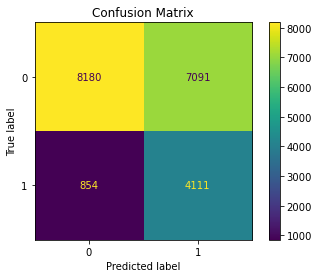

In [70]:
show_report(y_test,y_test_pred)

In [71]:
from sklearn.pipeline import make_pipeline

In [72]:
full_clf_pipeline = make_pipeline(feat_eng_pipe(), cb1)
#this pipeline will apply feature engineering and get predictions in a single step
# we will just has to supply the raw data and rest will be taken care

# Exporting the model

In [73]:
from joblib import dump, load
dump(full_clf_pipeline, 'model.joblib') # saving pipeline model

['model.joblib']

In [74]:
clf = load('model.joblib')

# Predictions on new data

In [75]:
df_test = pd.read_csv(path+'/Classification1Test.txt', sep='\t')
df_test.head()

,Index,F1,F2,F3,F4,F5,F6,F7,F8,F9,...,F13,F14,F15,F16,F17,F18,F19,F20,F21,F22
0,T30234341,0.654765,0.812009,0.603190,0.391039,-5220,4825,-1784,7447,-7147,...,8074343777,5553595074,9/17/1996,8/18/1990,1,1,436,478,1,1
1,T30234342,0.694636,0.690568,0.473460,0.259760,-618,-5018,2012,9259,9267,...,-5556861821,2216284070,11/7/1985,4/11/1990,1,1,138,56,10,4
2,T30234343,0.203759,0.323301,0.492294,0.011448,-8778,6141,6965,3774,4303,...,-2121815725,-315409510,7/9/1984,5/4/1997,1,1,117,323,10,1
3,T30234344,0.319627,0.286247,0.906197,0.093840,-7929,4471,7715,9543,335,...,1389754605,-3360224957,6/3/1987,7/1/1988,1,1,115,149,16,21
4,T30234345,0.236003,0.782784,0.285689,0.383585,-3296,4564,-1580,-8559,-27,...,3653338555,7604838279,7/17/1984,12/3/1993,1,1,527,281,3,1


In [76]:
y_pred_proba = clf.predict_proba(df_test)[:,1]
y_pred = np.where(y_pred_proba>=cb_best_thresh, 1, 0) #creating labels based on best threshold

df_test_pred = pd.DataFrame({'Index':df_test.Index, 'Class':y_pred}) # creating dataframe of predictions for each index on df_test
df_test_pred.head(5)

,Index,Class
0,T30234341,1
1,T30234342,0
2,T30234343,1
3,T30234344,0
4,T30234345,1


In [77]:
df_test_pred.to_csv('df_test_pred.csv', index=False, sep='\t') # saving as tab-delim csv

In [78]:
cb_best_thresh

0.5596943884368616

# Script
- script that can be used on a input file with the 22 features and returns the class for each data point

In [79]:
# import pandas as pd
# import numpy as np
# from joblib import load



# path = input("Enter the full path of Dataframe without label: ")
# sep = input("Enter deliminiter/seperator: ")

# df = pd.read_csv(path, sep=sep)


# model_path = input("Enter the full path of saved model: ")

# clf = load(model_path) 
# best_thresh = 0.5596943884368616
# y_pred_proba = clf.predict_proba(df)[:,1]
# y_pred = np.where(y_pred_proba>=best_thresh, 1, 0) #creating labels based on best threshold


# df_pred = pd.DataFrame({'Index':df.Index, 'Class':y_pred}) # creating dataframe of predictions for each index on df_test

# save_path = input("Enter the path where you want the results (include filename with csv extension): ")
# df_pred.to_csv(save_path, index=False, sep=sep)

